In [1]:
import os
import numpy as np
import pandas as pd
from sklearn import tree
from sklearn import ensemble
from sklearn import linear_model
from sklearn import metrics
import xgboost as xgb

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.offline as pyoff
import plotly.graph_objs as go
import plotly.express as px

matplotlib.rcParams['figure.figsize'] = (10,8)

In [2]:
# read the csv file
file_path = "D:\Murtaza\machine_learning_projects\mlframework\PrognosixAG-CaseStudy\input/"
df = pd.read_csv(file_path + "tomatoesAndFeatures.csv", delimiter=';', parse_dates=['date'])
df = df.sort_values(by="date")

In [3]:
df.head()

,date,salesAmount,promotionYes,bridgeDayYes,publicHolidayYes,seasonCode,seasonName,calendarWeek,newSnowCode,newSnowDescription,rainCode,rainDescription,sunshineCode,sunShineDescription,temperaturCode,temperatureDescription,shopsClosedYes,weekdayCode,weekDayDescription
0,2012-11-01,4574,0,0,0,3,Herbst,44,0,kein Schnee,4,feuchter als Mittel,5,viel mehr als Mittel,4,waermer als Mittel,0,5,Donnerstag
1,2012-11-02,6531,0,0,0,3,Herbst,44,0,kein Schnee,4,feuchter als Mittel,4,mehr als Mittel,5,viel waermer als Mittel,0,6,Freitag
2,2012-11-03,7291,0,0,0,3,Herbst,44,0,kein Schnee,3,Mittel,5,viel mehr als Mittel,5,viel waermer als Mittel,0,7,Samstag
3,2012-11-04,611,0,0,0,3,Herbst,44,0,kein Schnee,5,viel feuchter als Mittel,4,mehr als Mittel,5,viel waermer als Mittel,1,1,Sonntag
4,2012-11-05,4732,0,0,0,3,Herbst,45,0,kein Schnee,5,viel feuchter als Mittel,4,mehr als Mittel,4,waermer als Mittel,0,2,Montag


In [4]:
df.describe()

,salesAmount,promotionYes,bridgeDayYes,publicHolidayYes,seasonCode,calendarWeek,newSnowCode,rainCode,sunshineCode,temperaturCode,shopsClosedYes,weekdayCode
count,1769.000000,1769.000000,1769.000000,1769.000000,1769.000000,1769.000000,1769.000000,1769.000000,1769.000000,1769.000000,1769.000000,1769.000000
mean,8381.525155,0.213680,0.006783,0.036744,2.474845,26.169022,0.136800,2.527982,2.936687,3.024308,0.172414,4.000565
std,5187.583254,0.410019,0.082105,0.188186,1.131393,15.118133,0.486756,1.682164,1.453835,1.426549,0.377847,2.001555
min,467.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1.000000
25%,5380.000000,0.000000,0.000000,0.000000,1.000000,13.000000,0.000000,1.000000,1.000000,2.000000,0.000000,2.000000
50%,7285.000000,0.000000,0.000000,0.000000,2.000000,26.000000,0.000000,1.000000,3.000000,3.000000,0.000000,4.000000
75%,11124.000000,0.000000,0.000000,0.000000,4.000000,39.000000,0.000000,4.000000,4.000000,4.000000,0.000000,6.000000
max,32034.000000,1.000000,1.000000,1.000000,4.000000,53.000000,2.000000,5.000000,5.000000,5.000000,1.000000,7.000000


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1769 entries, 0 to 1768
Data columns (total 19 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   date                    1769 non-null   datetime64[ns]
 1   salesAmount             1769 non-null   int64         
 2   promotionYes            1769 non-null   int64         
 3   bridgeDayYes            1769 non-null   int64         
 4   publicHolidayYes        1769 non-null   int64         
 5   seasonCode              1769 non-null   int64         
 6   seasonName              1769 non-null   object        
 7   calendarWeek            1769 non-null   int64         
 8   newSnowCode             1769 non-null   int64         
 9   newSnowDescription      1769 non-null   object        
 10  rainCode                1769 non-null   int64         
 11  rainDescription         1769 non-null   object        
 12  sunshineCode            1769 non-null   int64   

In [5]:
# Description of the data
print("Rows:", df.shape[0])
print("Columns:", df.shape[1])
print("\nFeatures: \n", df.columns.tolist())
print("\nMissing Values: \n", df.isnull().any())
print("\nUnique Values: \n", df.nunique())

Rows: 1769
Columns: 19

Features: 
 ['date', 'salesAmount', 'promotionYes', 'bridgeDayYes', 'publicHolidayYes', 'seasonCode', 'seasonName', 'calendarWeek', 'newSnowCode', 'newSnowDescription', 'rainCode', 'rainDescription', 'sunshineCode', 'sunShineDescription', 'temperaturCode', 'temperatureDescription', 'shopsClosedYes', 'weekdayCode', 'weekDayDescription']

Missing Values: 
 date                      False
salesAmount               False
promotionYes              False
bridgeDayYes              False
publicHolidayYes          False
seasonCode                False
seasonName                False
calendarWeek              False
newSnowCode               False
newSnowDescription        False
rainCode                  False
rainDescription           False
sunshineCode              False
sunShineDescription       False
temperaturCode            False
temperatureDescription    False
shopsClosedYes            False
weekdayCode               False
weekDayDescription        False
dtype: bool

In [6]:
df_not_indexed = df.copy()
df_not_indexed['month'] = df_not_indexed['date'].apply(lambda x: x.month) 
df_date_indexed = df_not_indexed.set_index('date')

In [7]:
df_date_indexed.index           

DatetimeIndex(['2012-11-01', '2012-11-02', '2012-11-03', '2012-11-04',
               '2012-11-05', '2012-11-06', '2012-11-07', '2012-11-08',
               '2012-11-09', '2012-11-10',
               ...
               '2017-08-26', '2017-08-27', '2017-08-28', '2017-08-29',
               '2017-08-30', '2017-08-31', '2017-09-01', '2017-09-02',
               '2017-09-03', '2017-09-04'],
              dtype='datetime64[ns]', name='date', length=1769, freq=None)

In [9]:
df_date_indexed.head()

,salesAmount,promotionYes,bridgeDayYes,publicHolidayYes,seasonCode,seasonName,calendarWeek,newSnowCode,newSnowDescription,rainCode,rainDescription,sunshineCode,sunShineDescription,temperaturCode,temperatureDescription,shopsClosedYes,weekdayCode,weekDayDescription,month
date,,,,,,,,,,,,,,,,,,,
2012-11-01,4574,0,0,0,3,Herbst,44,0,kein Schnee,4,feuchter als Mittel,5,viel mehr als Mittel,4,waermer als Mittel,0,5,Donnerstag,11
2012-11-02,6531,0,0,0,3,Herbst,44,0,kein Schnee,4,feuchter als Mittel,4,mehr als Mittel,5,viel waermer als Mittel,0,6,Freitag,11
2012-11-03,7291,0,0,0,3,Herbst,44,0,kein Schnee,3,Mittel,5,viel mehr als Mittel,5,viel waermer als Mittel,0,7,Samstag,11
2012-11-04,611,0,0,0,3,Herbst,44,0,kein Schnee,5,viel feuchter als Mittel,4,mehr als Mittel,5,viel waermer als Mittel,1,1,Sonntag,11
2012-11-05,4732,0,0,0,3,Herbst,45,0,kein Schnee,5,viel feuchter als Mittel,4,mehr als Mittel,4,waermer als Mittel,0,2,Montag,11


In [16]:
# better visualization for the amount of sales from 2012 to 2017 
fig = px.line(df_not_indexed, x='date', y='salesAmount', title='Amount of Sales')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

In [17]:
df_date_indexed[:][['month', 'salesAmount']].groupby('month').describe()

salesAmount                                                              \
            count         mean          std    min      25%     50%       75%   
month                                                                           
1           155.0  8990.316129  6353.546181  484.0  5177.50  7525.0  11462.50   
2           141.0  8845.730496  5027.464503  639.0  5830.00  8030.0  11204.00   
3           155.0  9357.154839  5611.603964  702.0  6177.50  8516.0  12242.50   
4           150.0  7934.180000  4723.711344  640.0  5244.75  7403.0  10270.00   
5           155.0  8067.109677  5412.149242  531.0  4577.50  7099.0  10759.00   
6           150.0  8969.353333  5478.209560  773.0  5740.50  7818.5  12039.75   
7           155.0  7750.832258  4630.704584  696.0  5365.00  6519.0   9953.00   
8           155.0  8272.825806  5189.544757  976.0  5803.50  7103.0  10310.00   
9           124.0  8505.516129  5062.694190  764.0  5665.00  7191.5  11365.25   
10          124.0  8100.032258  4782.616138  886.0  5384.75  6917.5  11340.25   
11          150.0  7651.900000  4543.549885  611.0  5150.50  6687.5   9987.50   
12          155.0  8124.774194  4886.611583  467.0  5011.00  7543.0  11446.50   

                
           max  
month           
1      32034.0  
2      25577.0  
3      27521.0  
4      24873.0  
5      28233.0  
6      26052.0  
7      25834.0  
8      26984.0  
9      23866.0  
10     21831.0  
11     24130.0  
12     21694.0

The above table tells us that though the max sale occured in the month of January but that was for just one instant. The mean for the month of March is the highest that clearly tells that most of the sales occur in March. 

The lowest sale occur in the month of July, the climate can be one of the reason for this, because in Germany, the summer is at its extreme in the month of July which might affect the growth of tomatoes. 

## Finding relation between features

array([<matplotlib.axes._subplots.AxesSubplot object at 0x00000291392D0E88>,
      dtype=object)

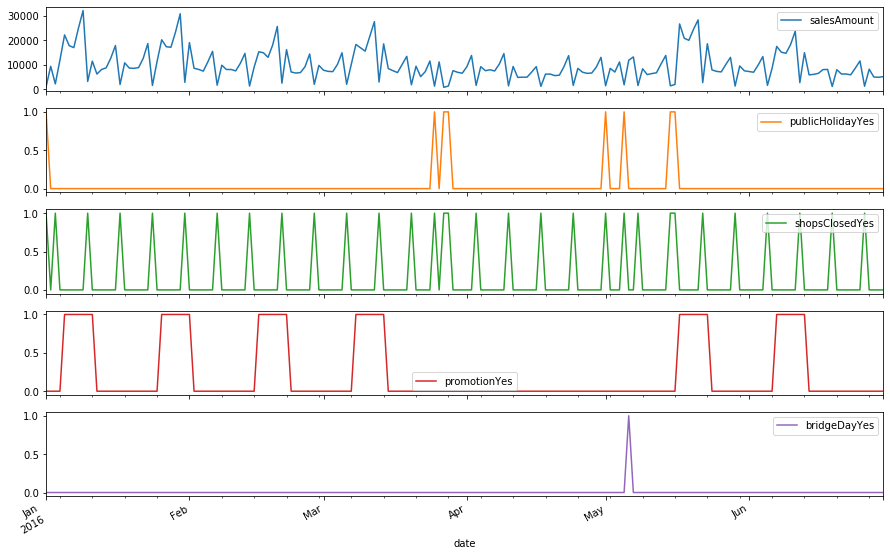

In [20]:
sales_calender_2016 = df_date_indexed['2016-01-01':'2016-06-30']
sales_calender_2016 = sales_calender_2016[['salesAmount', 'publicHolidayYes', 'shopsClosedYes', 'promotionYes', 'bridgeDayYes']]
sales_calender_2016.plot(subplots=True, figsize=(15,10))

### Description of the above plot:
A. The sales are high:
- When there is no public holiday.
- When the shops are not closed.
- When there is a promotion day i.e. when the marketing of the tomatoes takes place (advertisement and offers takes place in the market - people purchase more).
- When there is a public holiday the shope remain close and also there are no promotions carried out.   

## salesAmount vs seasonName

In [88]:
df_date_indexed[:][['seasonName', 'salesAmount']].groupby('seasonName').describe()

salesAmount                                                    \
                 count         mean          std    min      25%     50%   
seasonName                                                                 
Fruehling        460.0  8458.452174  5296.277328  531.0  5399.25  7610.0   
Herbst           398.0  8057.469849  4785.513065  611.0  5327.00  6917.0   
Sommer           460.0  8324.065217  5120.577527  696.0  5576.75  7145.5   
Winter           451.0  8647.643016  5476.947548  467.0  5357.00  7642.0   

                               
                 75%      max  
seasonName                     
Fruehling   11320.75  28233.0  
Herbst      10787.00  24130.0  
Sommer      10608.00  26984.0  
Winter      11462.50  32034.0

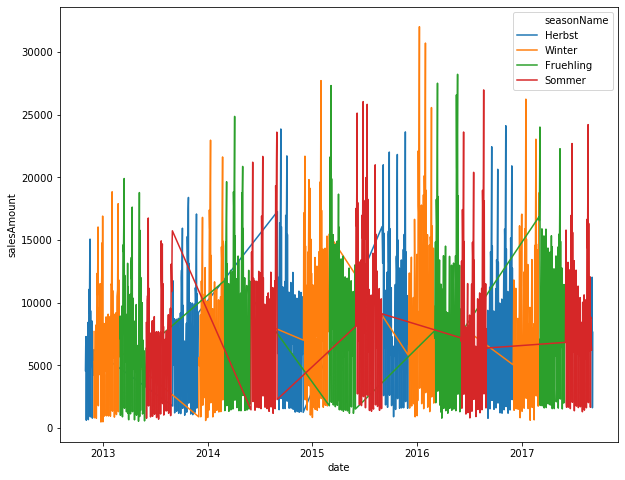

In [21]:
# seaborn 
sns.lineplot(data=df_not_indexed, x='date', y='salesAmount', hue='seasonName')

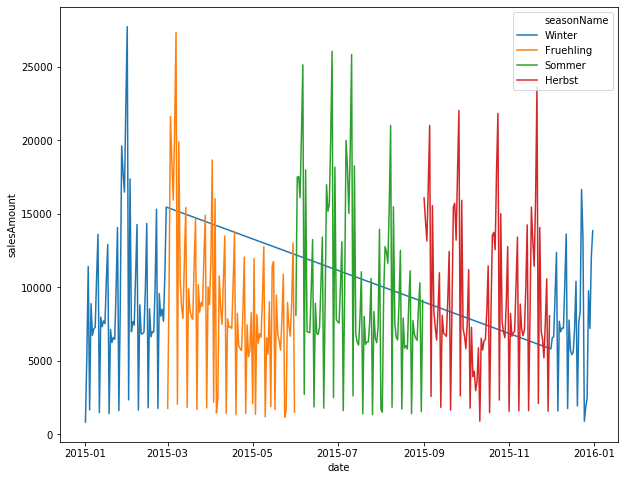

In [22]:
sns.lineplot(data=df_date_indexed_2015.reset_index(), x='date', y='salesAmount', hue='seasonName')

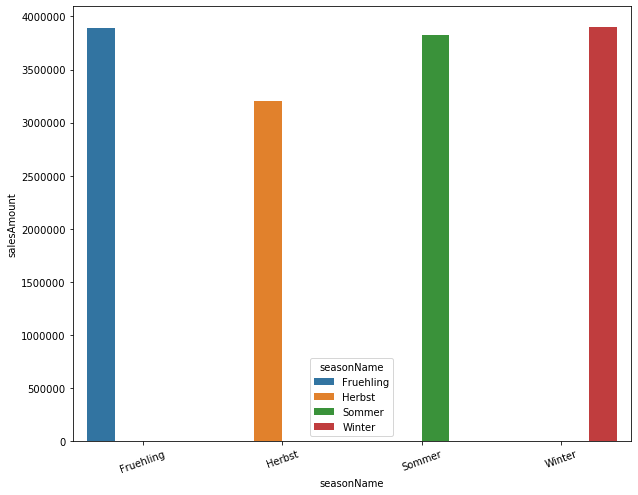

<Figure size 720x576 with 0 Axes>

In [9]:
season_grpd = df_not_indexed.groupby(['seasonName']).sum()
sns.barplot(data=season_grpd.reset_index(), x='seasonName', y='salesAmount', hue='seasonName')
plt.xticks(rotation=20)
plt.figure(figsize=(10,8))
plt.tight_layout()

- From the above plot and description the sales amount do not vary significantly with season. 
- The sales are maximum during winter which is suprising and then in spring (Frühling)
- The sales are minimum in autumn.   
### -----------------------------------------------------------------------------------------------------------------------------------------------------------------


## salesAmount vs newSnowDescription           

In [91]:
df_date_indexed[:][['newSnowDescription', 'salesAmount']].groupby('newSnowDescription').describe()

salesAmount                                            \
                              count         mean          std    min      25%   
newSnowDescription                                                              
kein Schnee                  1632.0  8393.091299  5179.297978  467.0  5417.75   
mehr als 1 cm Schnee          105.0  8753.047619  5617.733642  763.0  5220.00   
weniger als 1 cm Schnee        32.0  6572.593750  3704.176848  702.0  4557.50   

                                                    
                            50%       75%      max  
newSnowDescription                                  
kein Schnee              7296.5  11127.75  32034.0  
mehr als 1 cm Schnee     7605.0  11730.00  27728.0  
weniger als 1 cm Schnee  6363.0   8866.75  13142.0

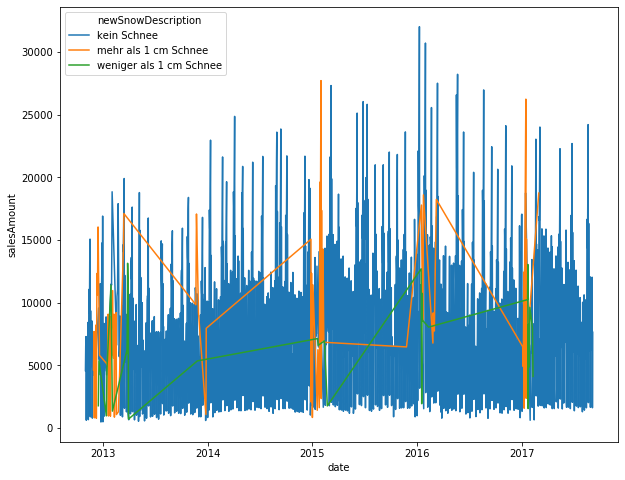

In [22]:
sns.lineplot(data=df_not_indexed, x='date', y='salesAmount', hue='newSnowDescription')

In [23]:
snow_grpd = df_not_indexed.groupby(['newSnowDescription']).sum()

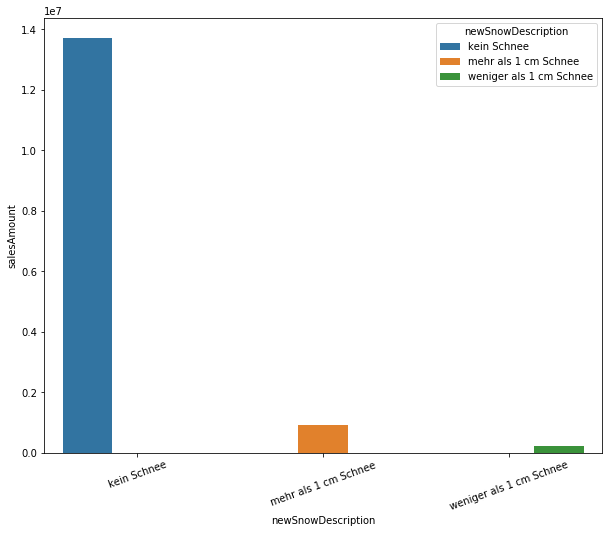

<Figure size 720x576 with 0 Axes>

In [25]:
sns.barplot(data=snow_grpd.reset_index(), x='newSnowDescription', y='salesAmount', hue='newSnowDescription')
plt.xticks(rotation=20)
plt.figure(figsize=(10,8))
plt.tight_layout()

array([<matplotlib.axes._subplots.AxesSubplot object at 0x0000016AC38F36C8>,
      dtype=object)

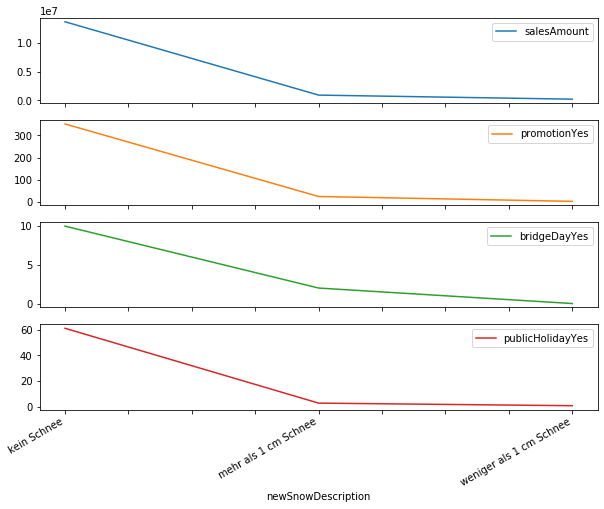

In [26]:
sg = snow_grpd[['salesAmount', 'promotionYes', 'bridgeDayYes', 'publicHolidayYes']]
sg.plot(subplots=True, figsize=(10,8))

From the above plot and description we arrive to following conclusions:
- The sales of the tomatoes are not really affected by the snowfall
- The sales are max when there is no snowfall but the event of snowfall occurs for only a small window (two months) in the year.
### -----------------------------------------------------------------------------------------------------------------------------------------------------------------


## salesAmount vs rainDescription

In [87]:
df_date_indexed[:][['rainDescription', 'salesAmount']].groupby('rainDescription').describe()

salesAmount                                     \
                                count          mean          std     min   
rainDescription                                                            
Mittel                          164.0   8427.152439  5815.886521   557.0   
feuchter als Mittel             337.0   8372.715134  5269.367883   484.0   
trockener als Mittel              4.0  11314.750000  7536.396813  1930.0   
viel feuchter als Mittel        340.0   8389.314706  5641.395300   467.0   
viel trockener als Mittel       924.0   8361.075758  4853.370660   531.0   

                                                                
                               25%      50%       75%      max  
rainDescription                                                 
Mittel                     4842.75   7017.0  12177.75  27728.0  
feuchter als Mittel        5204.00   7192.0  11203.00  26984.0  
trockener als Mittel       6866.50  12804.0  17252.25  17721.0  
viel feuchter als Mittel   5026.50   7174.5  11432.50  32034.0  
viel trockener als Mittel  5680.00   7472.0  10644.50  28233.0

In [27]:
rain_grpd = df_not_indexed.groupby(['rainDescription']).sum()

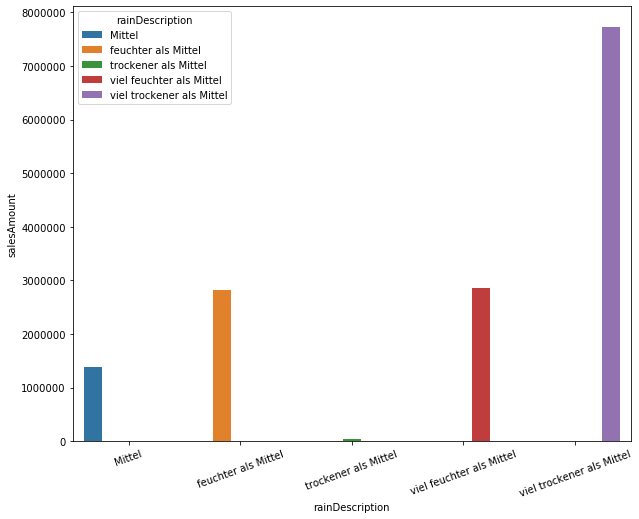

<Figure size 720x576 with 0 Axes>

In [31]:
sns.barplot(data=rain_grpd.reset_index(), x='rainDescription', y='salesAmount', hue='rainDescription')
plt.xticks(rotation=20)
plt.figure(figsize=(10,8))
plt.tight_layout()

array([<matplotlib.axes._subplots.AxesSubplot object at 0x0000016AC595E588>,
      dtype=object)

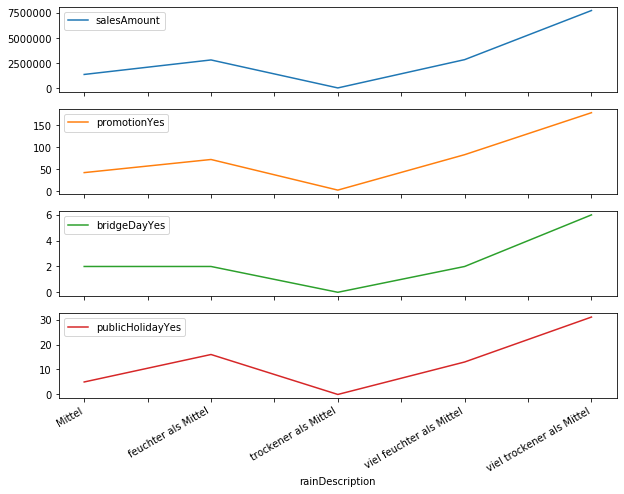

In [32]:
rg = rain_grpd[['salesAmount', 'promotionYes', 'bridgeDayYes', 'publicHolidayYes']]
rg.plot(subplots=True, figsize=(10,8))

From the above plot and description we arrive to following conclusions:
- The mean can be deceiving in above table because the mean of the sales are maximum when the description of the rain is dry than medium however there are only 4 instances in the whole dataset where this condition was recorded. Moreover the amount of sales are least for this condition.
- Maximum sales occur when the condition is very moist than medium which is also an optimal temperature for the tomatoes to grow. However this condition stays for a short period of time throughout the year.
- The condition "very dry than medium" remains for the longest period of time thoughout the year but has a reasonable amount of sales for tomatoes. 

### -----------------------------------------------------------------------------------------------------------------------------------------------------------------
 

## salesAmount vs sunShineDescription          

In [90]:
df_date_indexed[:][['sunShineDescription', 'salesAmount']].groupby('sunShineDescription').describe()

salesAmount                                            \
                              count         mean          std    min      25%   
sunShineDescription                                                             
Mittel                        371.0  8445.646900  5130.909881  803.0  5408.50   
mehr als Mittel               358.0  8564.734637  5279.921173  467.0  5454.50   
viel mehr als Mittel          338.0  8482.757396  5028.543941  608.0  5633.50   
viel weniger als Mittel       444.0  8143.243243  5275.382460  484.0  5199.75   
weniger als Mittel            258.0  8312.542636  5216.046136  557.0  5276.00   

                                                    
                            50%       75%      max  
sunShineDescription                                 
Mittel                   7547.0  11451.50  26589.0  
mehr als Mittel          7656.0  10911.75  30726.0  
viel mehr als Mittel     7431.0  11141.25  28233.0  
viel weniger als Mittel  6946.0  10885.75  32034.0  
weniger als Mittel       7143.0  10871.50  24216.0

In [34]:
sunssh_grpd = df_not_indexed.groupby(['sunShineDescription']).sum()

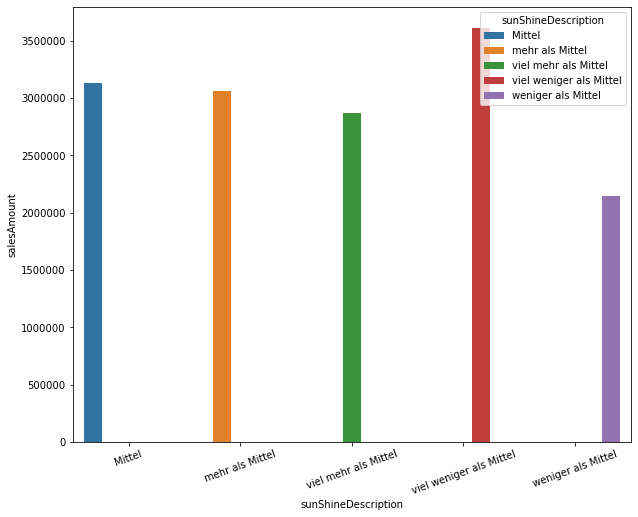

<Figure size 720x576 with 0 Axes>

In [35]:
sns.barplot(data=sunssh_grpd.reset_index(), x='sunShineDescription', y='salesAmount', hue='sunShineDescription')
plt.xticks(rotation=20)
plt.figure(figsize=(10,8))
plt.tight_layout()

array([<matplotlib.axes._subplots.AxesSubplot object at 0x0000016AC6359708>,
      dtype=object)

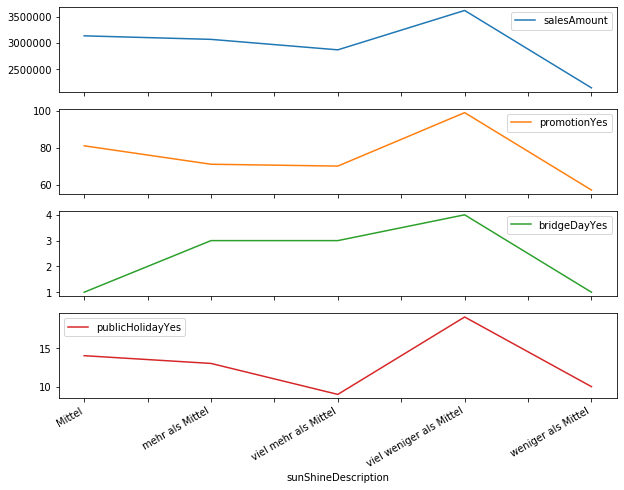

In [36]:
ssh = sunssh_grpd[['salesAmount', 'promotionYes', 'bridgeDayYes', 'publicHolidayYes']]
ssh.plot(subplots=True, figsize=(10,8))

From the above plot and description we arrive to following conclusions:
- Clearly the sunshine is much low throughout the year for this particular place in Germany where the tomatoes are grown. 
- In general, the sales are not much affected by the varying conditions of the sunshine but in theory it should. One of the reason to maintain the sales can be that the customer might be using artificial lighting because the standard deviation for all the conditions of the sunshine are almost the same which indicates that there is a huge fluctuation in the intesity of the sunshine throughout the year.   

### -----------------------------------------------------------------------------------------------------------------------------------------------------------------


## salesAmount vs temperatureDescription

In [89]:
df_date_indexed[:][['temperatureDescription', 'salesAmount']].groupby('temperatureDescription').describe()

salesAmount                                            \
                              count         mean          std    min      25%   
temperatureDescription                                                          
Mittel                        348.0  8242.330460  5068.819371  531.0  5449.00   
kaelter als Mittel            336.0  8326.773810  5483.432801  608.0  5269.25   
viel kaelter als Mittel       358.0  7983.472067  4601.724139  557.0  5290.00   
viel waermer als Mittel       368.0  8572.750000  5147.203464  467.0  5723.00   
waermer als Mittel            359.0  8768.623955  5587.232856  484.0  5357.00   

                                                    
                            50%       75%      max  
temperatureDescription                              
Mittel                   6960.5  10944.75  27521.0  
kaelter als Mittel       7014.5  11043.50  27728.0  
viel kaelter als Mittel  7109.5  10505.50  27334.0  
viel waermer als Mittel  7724.0  11201.00  32034.0  
waermer als Mittel       7642.0  11914.00  28233.0

In [38]:
temp_grpd = df_not_indexed.groupby(['temperatureDescription']).sum()

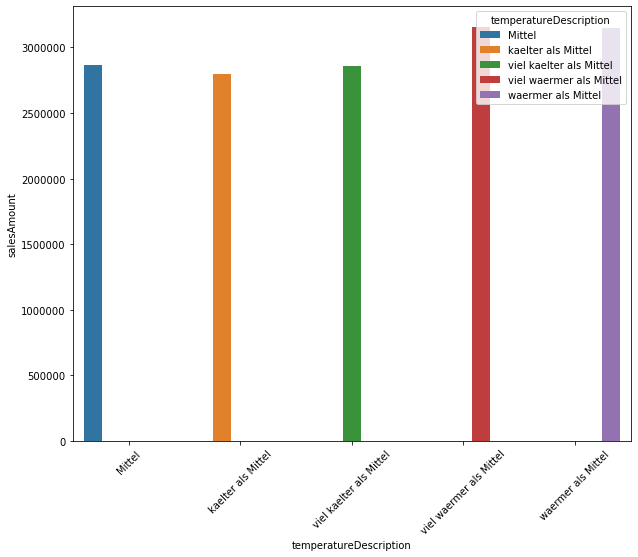

<Figure size 720x576 with 0 Axes>

In [39]:
sns.barplot(data=temp_grpd.reset_index(), x='temperatureDescription', y='salesAmount', hue='temperatureDescription')
plt.xticks(rotation=45)
plt.figure(figsize=(10,8))
plt.tight_layout()

array([<matplotlib.axes._subplots.AxesSubplot object at 0x0000016AC6AC9A08>,
      dtype=object)

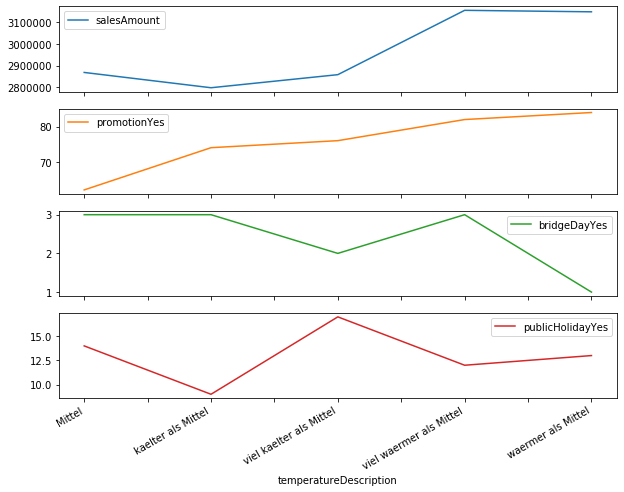

In [40]:
tg = temp_grpd[['salesAmount', 'promotionYes', 'bridgeDayYes', 'publicHolidayYes']]
tg.plot(subplots=True, figsize=(10,8))

From the above observation we arrive to following conclusions:
- The sale of tomatoes are not much affeted by the varying temperature
- Maximum sales occur when the temperature is very warm than medium.
- The least sales occur when the temperature is colder than medium.
- Public holidays are highest during peak winter (very cold than medium).
- Most of the promotions take place during the spring and summer season.

### -----------------------------------------------------------------------------------------------------------------------------------------------------------------


## Finding Correlations and Heat Map

In [42]:
# create ditionaries for mapping seasonName, newSnowDescription,
# rainDescription, sushineDescription, temperatureDescription, 
# and weekDayDescription

seasonCode = {}
newSnowCode = {}
rainCode = {}
sunshineCode = {}
temperatureCode = {}
weekdayCode = {}

codes = [
     'seasonCode', 
     'newSnowCode', 
     'rainCode', 
     'sunshineCode', 
     'temperaturCode', 
     'weekdayCode'
]

desc = [
    'seasonName', 
    'newSnowDescription',
    'rainDescription',
    'sunShineDescription',
    'temperatureDescription',
    'weekDayDescription'
]

for c, d in zip(codes, desc):
    for k, v in zip(df_not_indexed[c].unique(), df_not_indexed[d].unique()):
        if c == 'seasonCode':
            seasonCode[k] = v
        elif c == 'newSnowCode':
            newSnowCode[k] = v
        elif c == 'rainCode':
            rainCode[k] = v
        elif c == 'sunshineCode':
             sunshineCode[k] = v
        elif c == 'temperaturCode':
            temperatureCode[k] = v
        else:
            weekdayCode[k] = v

In [43]:
# dropping redundant columns

columns = [
    'seasonName', 
    'newSnowDescription',
    'rainDescription',
    'sunShineDescription',
    'temperatureDescription',
    'weekDayDescription'
]

df_new = df_not_indexed.drop(columns, axis=1)

In [44]:
df_new.head()

,date,salesAmount,promotionYes,bridgeDayYes,publicHolidayYes,seasonCode,calendarWeek,newSnowCode,rainCode,sunshineCode,temperaturCode,shopsClosedYes,weekdayCode,month
0,2012-11-01,4574,0,0,0,3,44,0,4,5,4,0,5,11
1,2012-11-02,6531,0,0,0,3,44,0,4,4,5,0,6,11
2,2012-11-03,7291,0,0,0,3,44,0,3,5,5,0,7,11
3,2012-11-04,611,0,0,0,3,44,0,5,4,5,1,1,11
4,2012-11-05,4732,0,0,0,3,45,0,5,4,4,0,2,11


In [45]:
columns = df_new.columns.to_list()

In [46]:
fltr_col = [
    col for col in columns if col not in ['date', 'month', 'calenderWeek']
]

In [47]:
fltr_col

['salesAmount',
 'promotionYes',
 'bridgeDayYes',
 'publicHolidayYes',
 'seasonCode',
 'calendarWeek',
 'newSnowCode',
 'rainCode',
 'sunshineCode',
 'temperaturCode',
 'shopsClosedYes',
 'weekdayCode']

<Figure size 720x576 with 0 Axes>

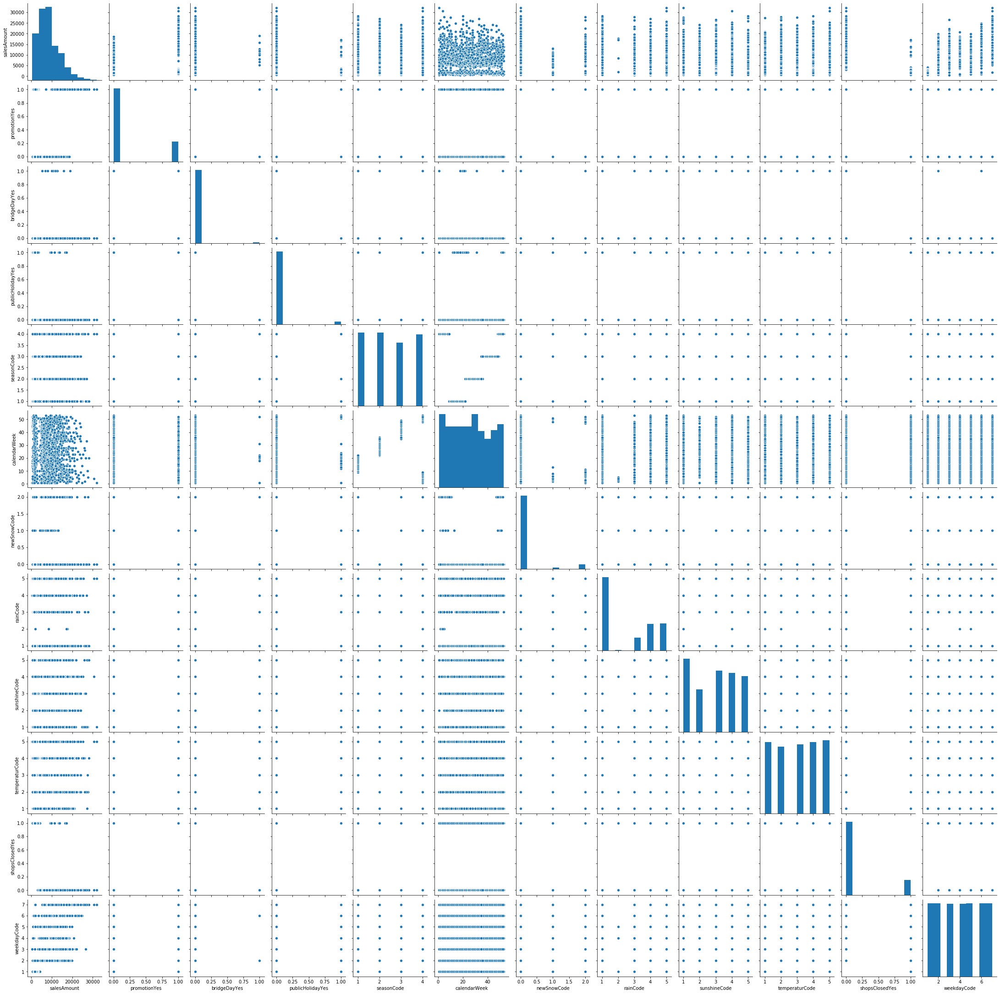

<Figure size 720x576 with 0 Axes>

In [48]:
pp = sns.pairplot(df_new[fltr_col])

In [49]:
weekdayCode

{5: 'Donnerstag',
 6: 'Freitag',
 7: 'Samstag',
 1: 'Sonntag',
 2: 'Montag',
 3: 'Dienstag',
 4: 'Mittwoch'}

In [50]:
temperatureCode

{4: 'waermer als Mittel',
 5: 'viel waermer als Mittel',
 2: 'kaelter als Mittel',
 3: 'Mittel',
 1: 'viel kaelter als Mittel'}

In [51]:
newSnowCode

{0: 'kein Schnee', 2: 'mehr als 1 cm Schnee', 1: 'weniger als 1 cm Schnee'}

In [52]:
seasonCode

{3: 'Herbst', 4: 'Winter', 1: 'Fruehling', 2: 'Sommer'}

In [53]:
rainCode

{4: 'feuchter als Mittel',
 3: 'Mittel',
 5: 'viel feuchter als Mittel',
 1: 'viel trockener als Mittel',
 2: 'trockener als Mittel'}

In [54]:
# Pearson Correlation
pearson_corr = df_new[fltr_col].corr(method='pearson')
print(pearson_corr)

                  salesAmount  promotionYes  bridgeDayYes  publicHolidayYes  \
salesAmount          1.000000      0.583338      0.042989         -0.193807   
promotionYes         0.583338      1.000000     -0.009479         -0.035840   
bridgeDayYes         0.042989     -0.009479      1.000000         -0.016141   
publicHolidayYes    -0.193807     -0.035840     -0.016141          1.000000   
seasonCode           0.007293      0.061584     -0.022517         -0.031520   
calendarWeek        -0.076375      0.001744     -0.012772          0.013323   
newSnowCode          0.004510     -0.004848      0.033377         -0.011683   
rainCode             0.001840      0.046270     -0.001375          0.019085   
sunshineCode         0.027255     -0.019041      0.003600         -0.026637   
temperaturCode       0.044567      0.012389     -0.001409         -0.015970   
shopsClosedYes      -0.568192     -0.015233     -0.037721          0.427900   
weekdayCode          0.532839     -0.000147      0.0

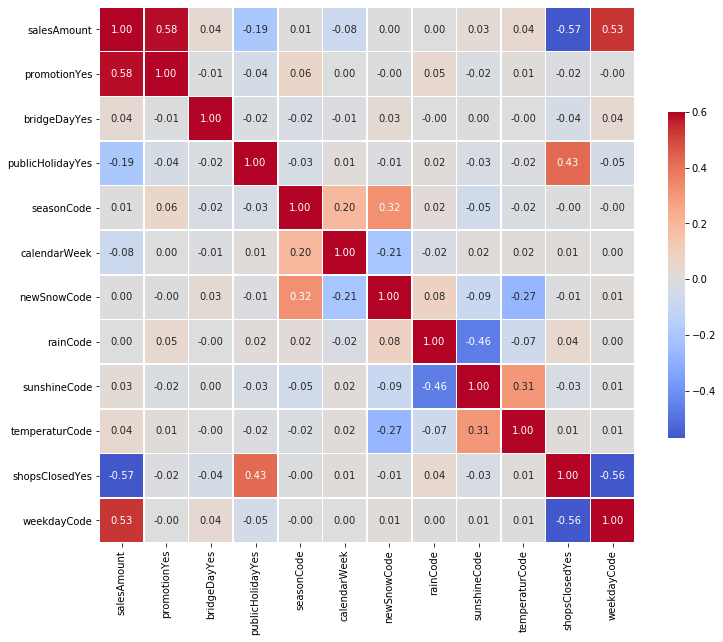

In [55]:
hm = sns.heatmap(
    pearson_corr,
    vmax = 0.6,
    center = 0,
    square = True,
    linewidth = 0.5,
    cbar_kws = {"shrink":0.5},
    annot = True,
    fmt = '.2f',
    cmap = 'coolwarm' 
)

hm.figure.set_size_inches(12,12)
plt.show()

The correlations represent the importance factor for each feature in the given dataset